In [1]:
import numpy as np
import matplotlib.pyplot as plt
import matplotlib.image as mpimg
import time

In [2]:
random_embeddings = np.load('random_pairs_cumulative/cumulative_embedding_output_random.npy')[:1000,:]
random_embeddings = random_embeddings+np.random.randn(*random_embeddings.shape)/10000

random_subembeddings = np.load('random_pairs_cumulative/cumulative_sub_embedding_output_random.npy')[:1000,:]
random_subembeddings = random_subembeddings+np.random.randn(*random_subembeddings.shape)/10000

# compute 90th percentile thresholds between all embeddings and sub-embeddings

In [3]:
# get embedding percentile thresholds
embeddings_for_percentile_comp= np.squeeze(np.load('alexnet_imgnet_embeddings_prelu_noise.npy'))
embeddings_for_percentile_comp = embeddings_for_percentile_comp+np.random.randn(*embeddings_for_percentile_comp.shape)/10000


sorted_indices_embedding = np.argsort(embeddings_for_percentile_comp,axis = 0)

indices_90_embedding = sorted_indices_embedding[900,:]

embedding_threshold_90 = embeddings_for_percentile_comp[indices_90_embedding, range(4096)].reshape(1,4096)


# get sub-embedding percentile thresholds
sub_embeddings_for_percentile_comp = np.squeeze(np.load('alexnet_imgnet_sub_embeddings_prelu_noise.npy'))
sub_embeddings_for_percentile_comp = sub_embeddings_for_percentile_comp+np.random.randn(*sub_embeddings_for_percentile_comp.shape)/10000

sorted_indices_sub_embedding = np.argsort(sub_embeddings_for_percentile_comp,axis = 0)

indices_90_sub_embedding = sorted_indices_sub_embedding[900,:]

sub_embedding_threshold_90 = sub_embeddings_for_percentile_comp[indices_90_sub_embedding, range(4096)].reshape(1,4096)


# compute number of co-active features between all pairs of embeddings

In [4]:
random_emb_active = (random_embeddings >= embedding_threshold_90)*1

random_emb_active_t = random_emb_active.T

co_active_features_random_emb = np.matmul(random_emb_active,random_emb_active_t)

co_active_features_random_emb_sorted = np.argsort(-co_active_features_random_emb,axis = 1)

average_random_emb = np.mean(co_active_features_random_emb)


# compute number of co-active features between all pairs of sub-embeddings

In [5]:
random_subemb_active = (random_subembeddings >= sub_embedding_threshold_90)*1

random_subemb_active_t = random_subemb_active.T

co_active_features_random_subemb = np.matmul(random_subemb_active,random_subemb_active_t)

co_active_features_random_subemb_sorted = np.argsort(-co_active_features_random_subemb,axis = 1)

average_random_subemb = np.mean(co_active_features_random_subemb)

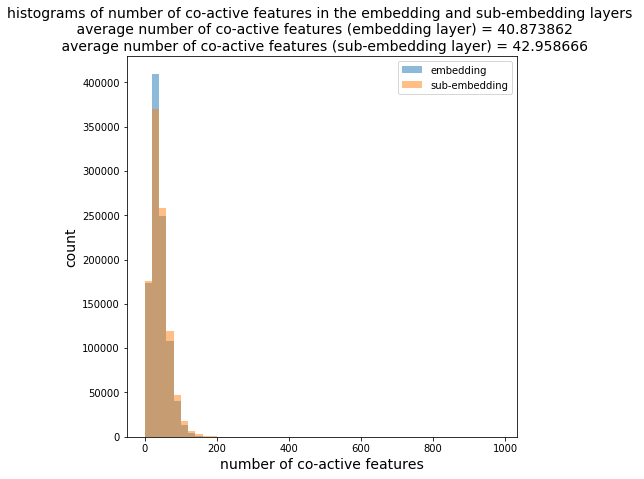

In [6]:
bins=np.linspace(np.min([np.min(co_active_features_random_subemb),np.min(co_active_features_random_emb)]),np.max([np.max(co_active_features_random_subemb),np.max(co_active_features_random_emb)]),50)

plt.figure(figsize=(7,7))

plt.title('histograms of number of co-active features in the embedding and sub-embedding layers \n average number of co-active features (embedding layer) = '+str(average_random_emb)+'\n average number of co-active features (sub-embedding layer) = '+str(average_random_subemb), fontsize=14)

plt.hist(co_active_features_random_emb.flatten(),bins=bins, label = 'embedding', alpha = 0.5)

plt.hist(co_active_features_random_subemb.flatten(),bins=bins, label = 'sub-embedding', alpha = 0.5)

plt.ylabel('count',fontsize=14)

plt.xlabel('number of co-active features',fontsize=14)

plt.legend()

plt.show()

plt.close()

# compute cosine similarity between all pairs of embeddings

In [7]:
random_embeddings_norm = (random_embeddings/np.sqrt(np.sum(random_embeddings*random_embeddings, axis=1)).reshape(-1,1))

random_embeddings_norm_t = random_embeddings_norm.T

cos_sims = np.matmul(random_embeddings_norm,random_embeddings_norm_t)

cos_sims_sorted = np.argsort(-cos_sims,axis = 1)

# compute cosine similarity between all pairs of sub-embeddings

In [8]:
random_subembeddings_norm = (random_subembeddings/np.sqrt(np.sum(random_subembeddings*random_subembeddings, axis=1)).reshape(-1,1))

random_subembeddings_norm_t = random_subembeddings_norm.T

cos_sims_sub = np.matmul(random_subembeddings_norm,random_subembeddings_norm_t)

cos_sims_sorted_sub = np.argsort(-cos_sims_sub,axis = 1)

# display reference image and 10 most similar images according to different metrics

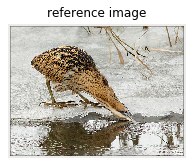

metric: cosine similarity between embeddings


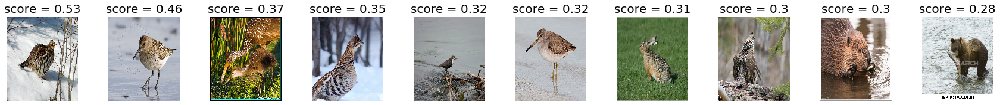

metric: number of co-active embedding features (out of 4096 features)


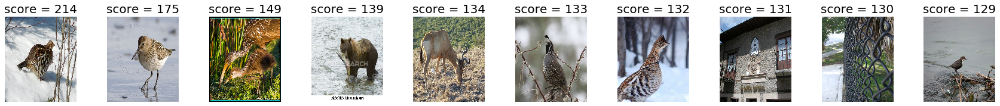

metric: cosine similarity between sub-embeddings


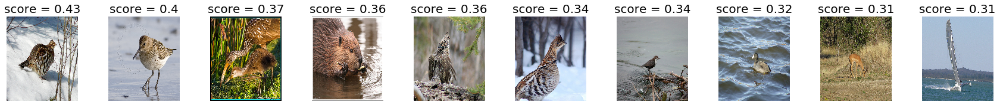

metric: number of co-active sub-embedding features (out of 4096 features)


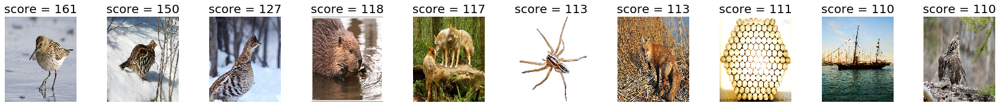

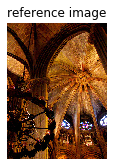

metric: cosine similarity between embeddings


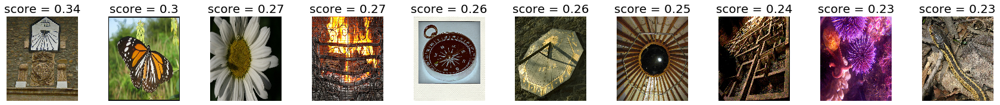

metric: number of co-active embedding features (out of 4096 features)


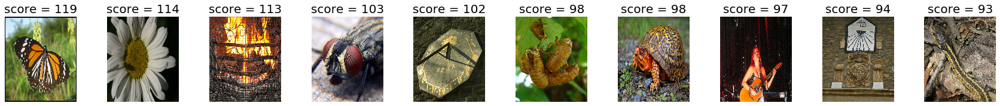

metric: cosine similarity between sub-embeddings


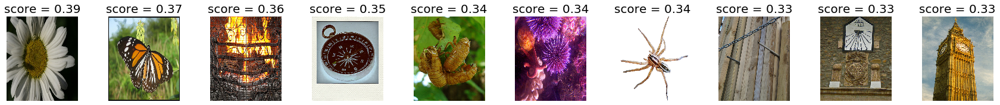

metric: number of co-active sub-embedding features (out of 4096 features)


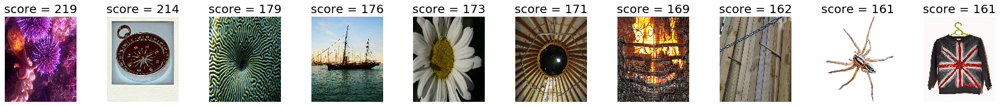

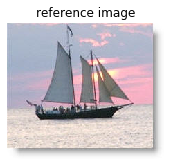

metric: cosine similarity between embeddings


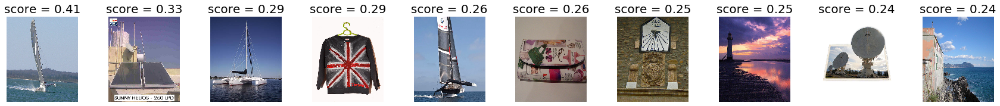

metric: number of co-active embedding features (out of 4096 features)


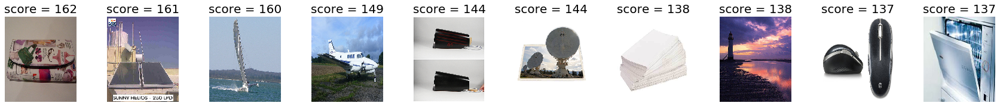

metric: cosine similarity between sub-embeddings


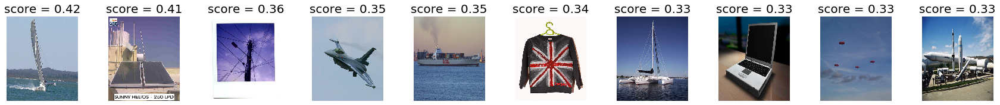

metric: number of co-active sub-embedding features (out of 4096 features)


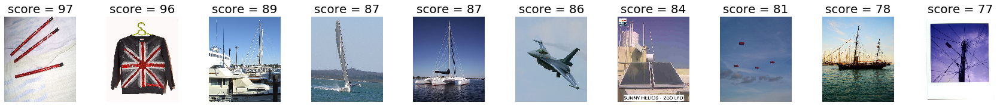

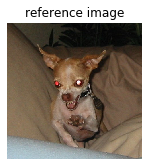

metric: cosine similarity between embeddings


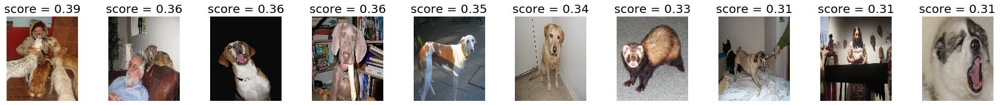

metric: number of co-active embedding features (out of 4096 features)


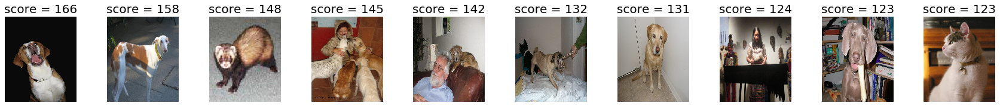

metric: cosine similarity between sub-embeddings


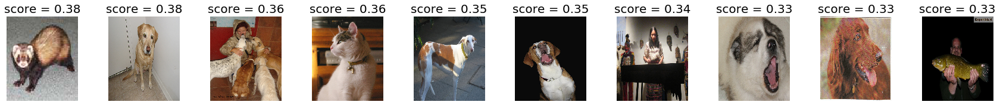

metric: number of co-active sub-embedding features (out of 4096 features)


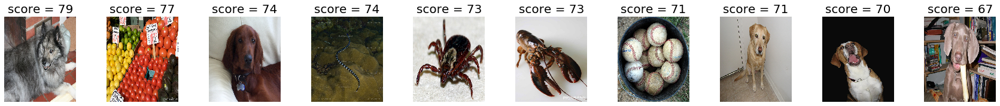

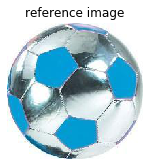

metric: cosine similarity between embeddings


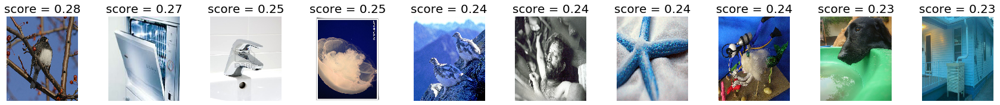

metric: number of co-active embedding features (out of 4096 features)


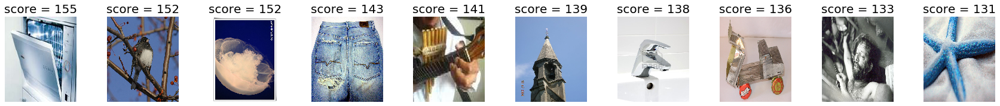

metric: cosine similarity between sub-embeddings


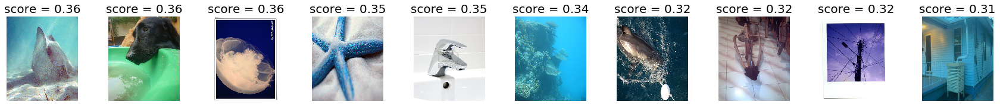

metric: number of co-active sub-embedding features (out of 4096 features)


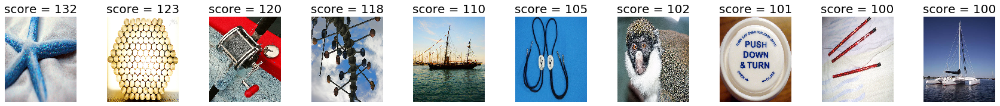

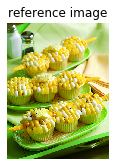

metric: cosine similarity between embeddings


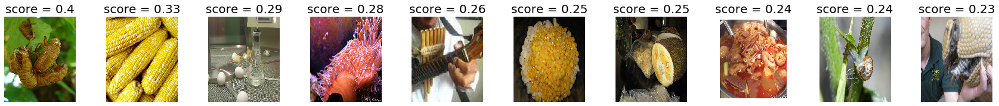

metric: number of co-active embedding features (out of 4096 features)


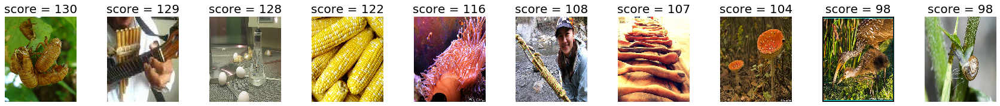

metric: cosine similarity between sub-embeddings


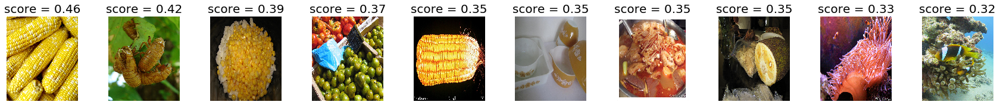

metric: number of co-active sub-embedding features (out of 4096 features)


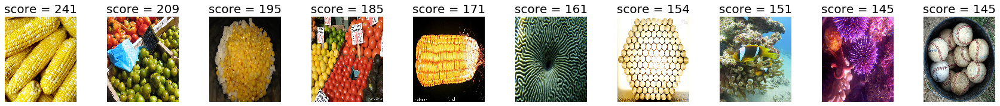

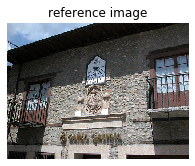

metric: cosine similarity between embeddings


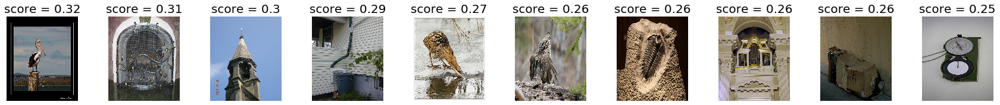

metric: number of co-active embedding features (out of 4096 features)


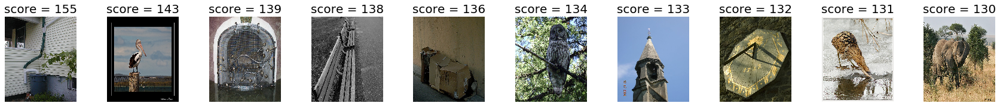

metric: cosine similarity between sub-embeddings


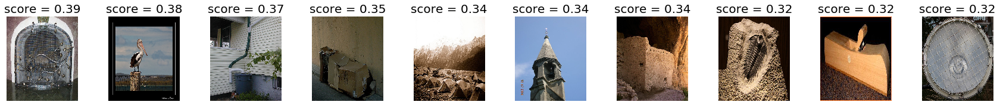

metric: number of co-active sub-embedding features (out of 4096 features)


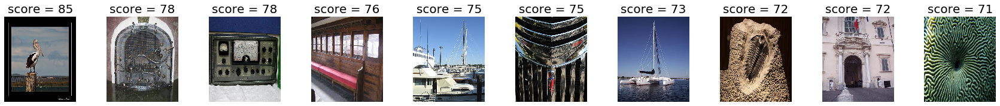

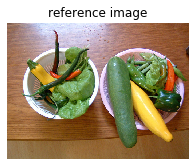

metric: cosine similarity between embeddings


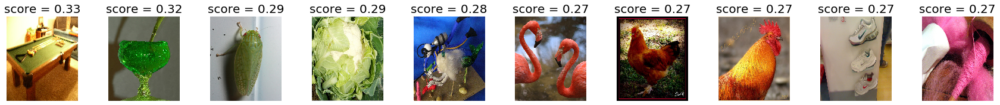

metric: number of co-active embedding features (out of 4096 features)


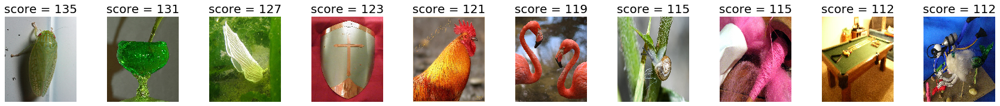

metric: cosine similarity between sub-embeddings


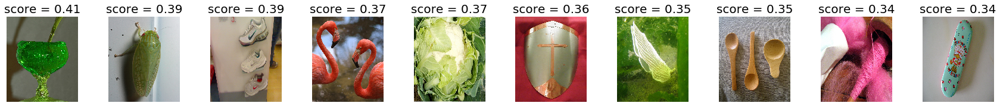

metric: number of co-active sub-embedding features (out of 4096 features)


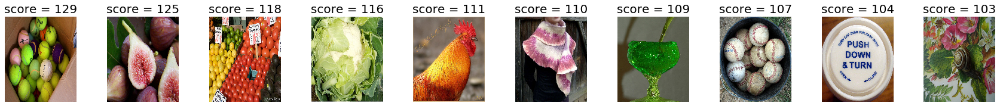

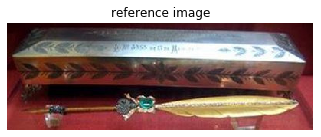

metric: cosine similarity between embeddings


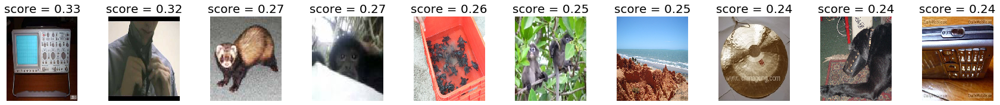

metric: number of co-active embedding features (out of 4096 features)


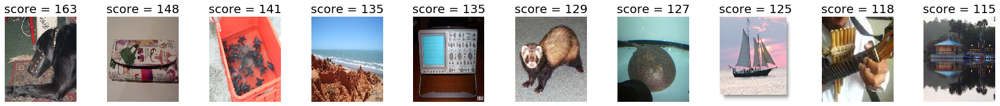

metric: cosine similarity between sub-embeddings


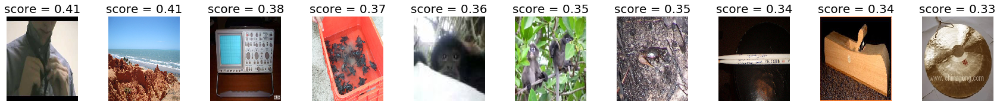

metric: number of co-active sub-embedding features (out of 4096 features)


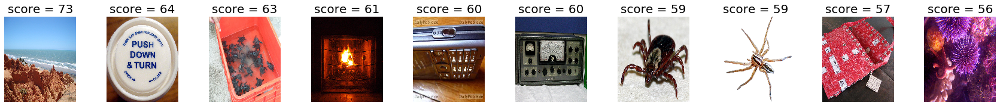

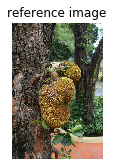

metric: cosine similarity between embeddings


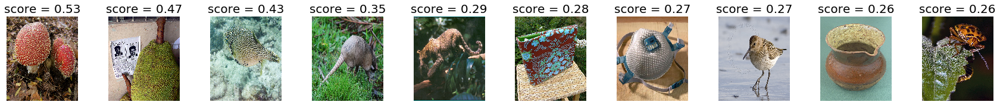

metric: number of co-active embedding features (out of 4096 features)


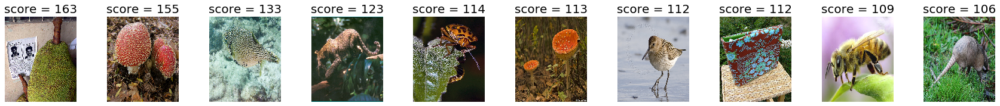

metric: cosine similarity between sub-embeddings


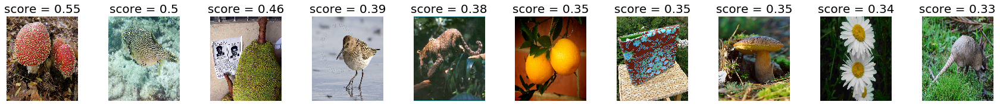

metric: number of co-active sub-embedding features (out of 4096 features)


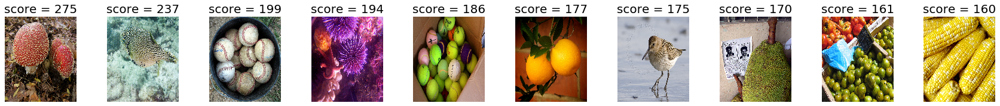

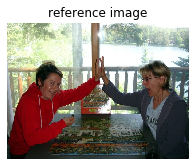

metric: cosine similarity between embeddings


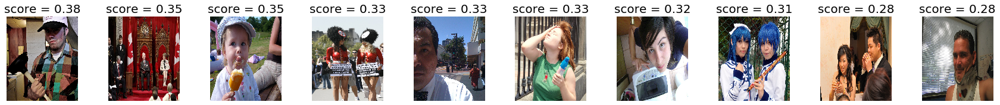

metric: number of co-active embedding features (out of 4096 features)


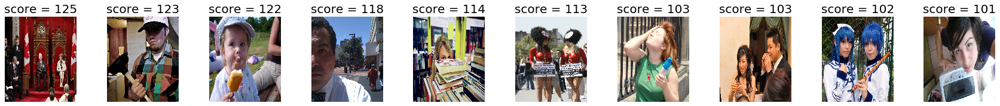

metric: cosine similarity between sub-embeddings


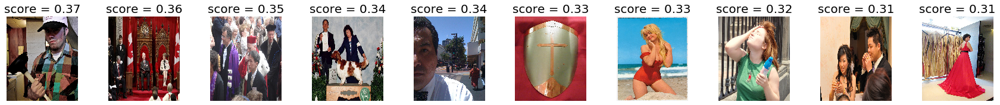

metric: number of co-active sub-embedding features (out of 4096 features)


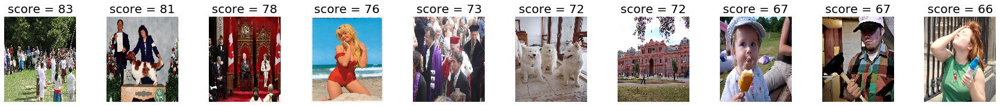

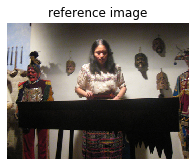

metric: cosine similarity between embeddings


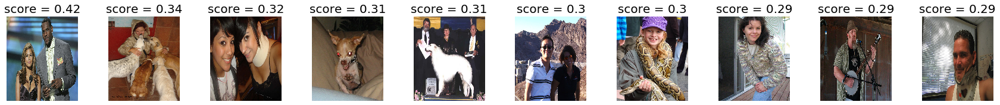

metric: number of co-active embedding features (out of 4096 features)


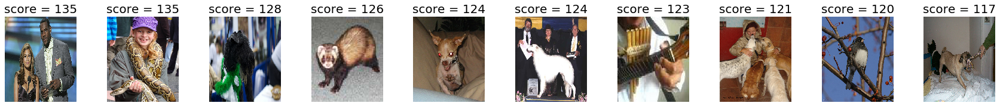

metric: cosine similarity between sub-embeddings


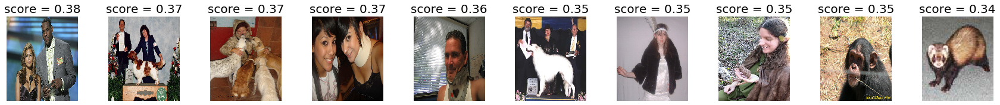

metric: number of co-active sub-embedding features (out of 4096 features)


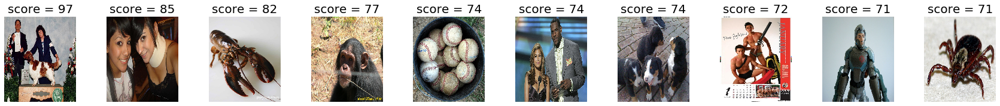

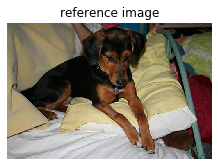

metric: cosine similarity between embeddings


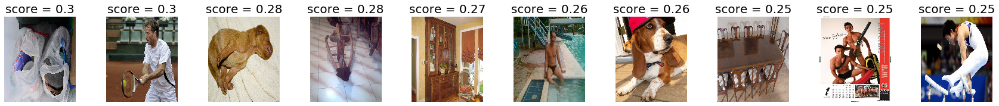

metric: number of co-active embedding features (out of 4096 features)


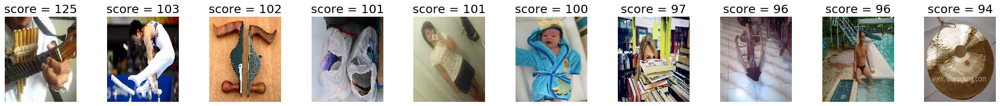

metric: cosine similarity between sub-embeddings


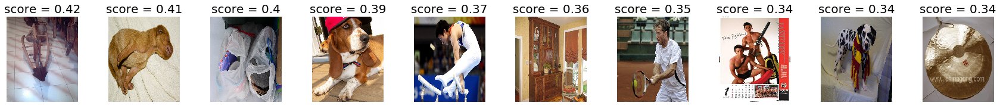

metric: number of co-active sub-embedding features (out of 4096 features)


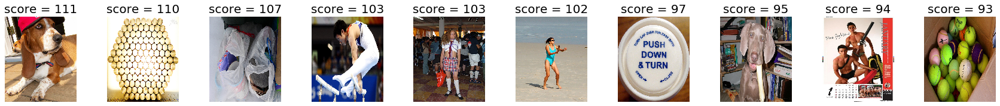

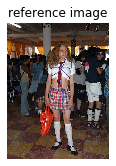

metric: cosine similarity between embeddings


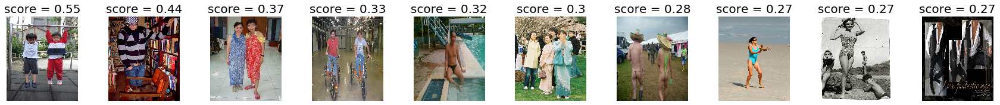

metric: number of co-active embedding features (out of 4096 features)


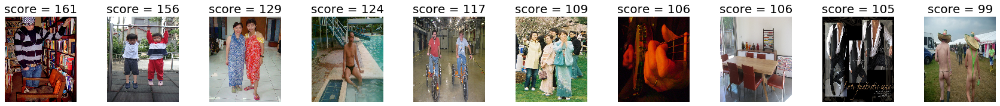

metric: cosine similarity between sub-embeddings


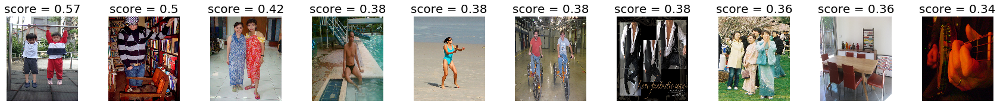

metric: number of co-active sub-embedding features (out of 4096 features)


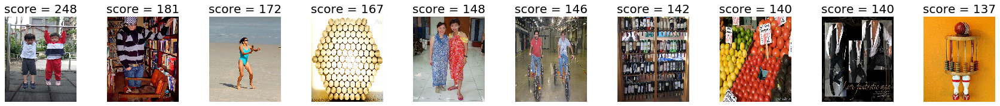

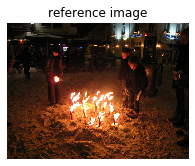

metric: cosine similarity between embeddings


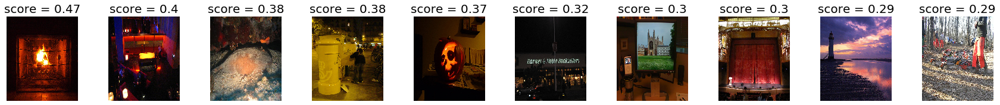

metric: number of co-active embedding features (out of 4096 features)


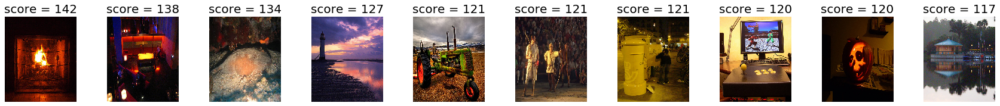

metric: cosine similarity between sub-embeddings


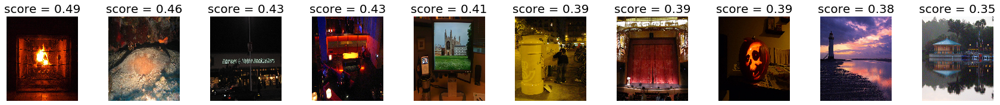

metric: number of co-active sub-embedding features (out of 4096 features)


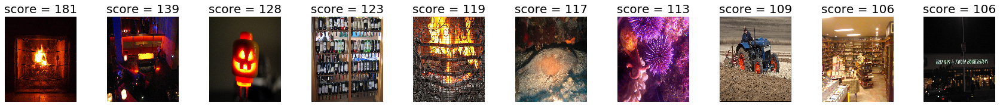

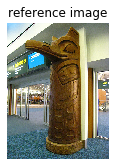

metric: cosine similarity between embeddings


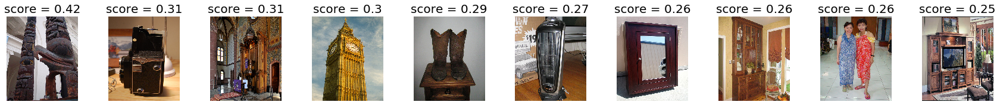

metric: number of co-active embedding features (out of 4096 features)


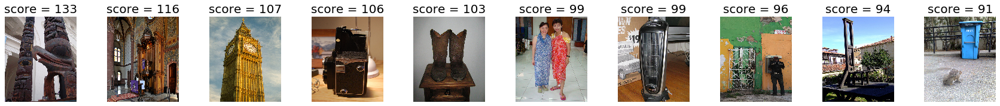

metric: cosine similarity between sub-embeddings


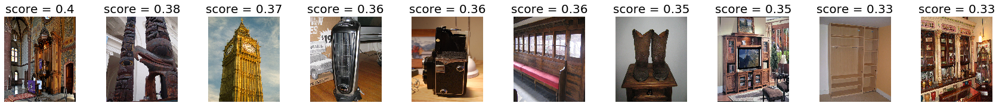

metric: number of co-active sub-embedding features (out of 4096 features)


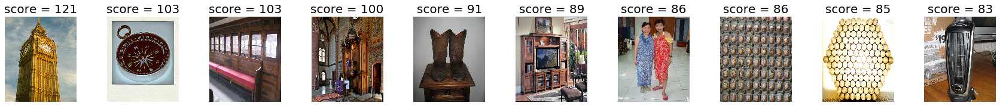

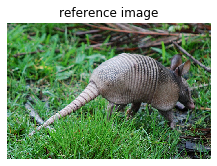

metric: cosine similarity between embeddings


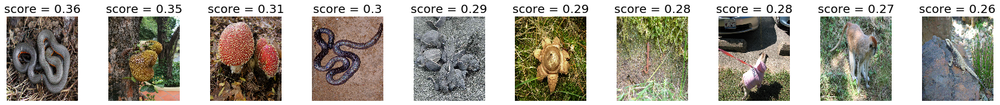

metric: number of co-active embedding features (out of 4096 features)


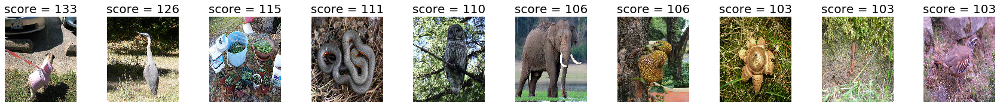

metric: cosine similarity between sub-embeddings


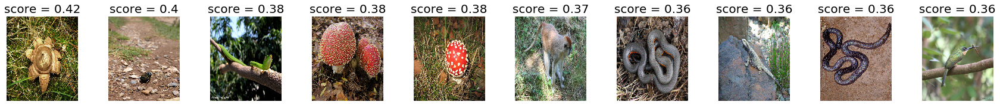

metric: number of co-active sub-embedding features (out of 4096 features)


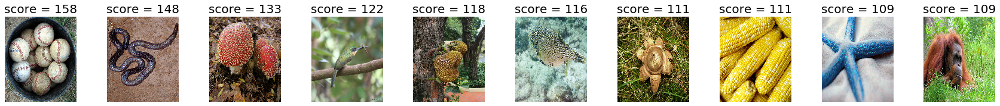

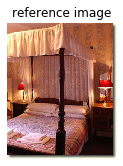

metric: cosine similarity between embeddings


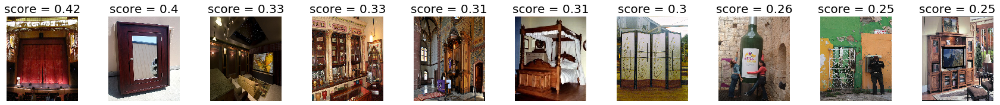

metric: number of co-active embedding features (out of 4096 features)


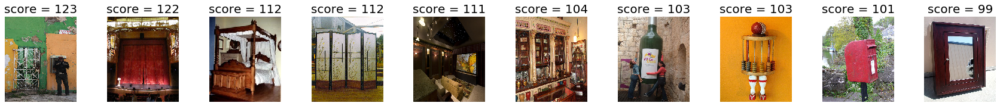

metric: cosine similarity between sub-embeddings


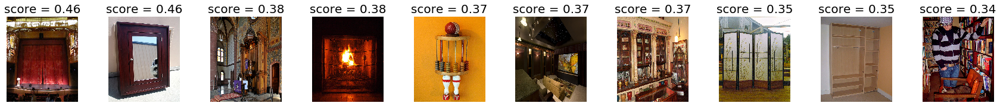

metric: number of co-active sub-embedding features (out of 4096 features)


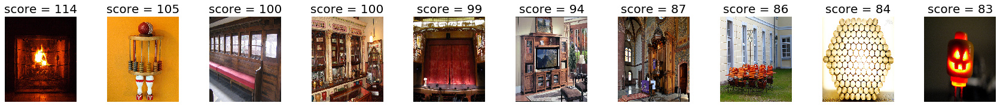

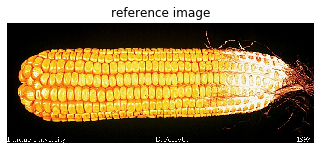

metric: cosine similarity between embeddings


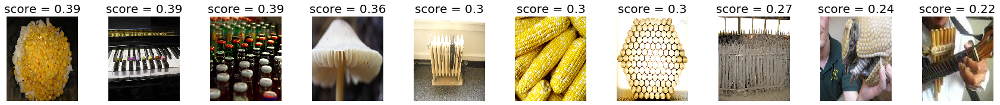

metric: number of co-active embedding features (out of 4096 features)


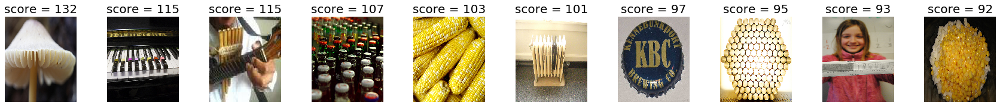

metric: cosine similarity between sub-embeddings


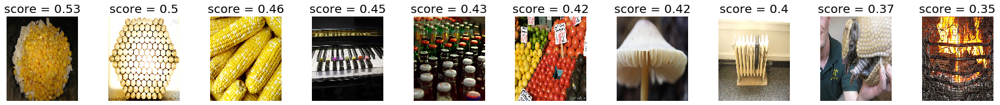

metric: number of co-active sub-embedding features (out of 4096 features)


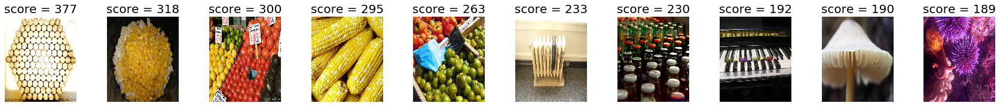

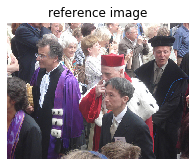

metric: cosine similarity between embeddings


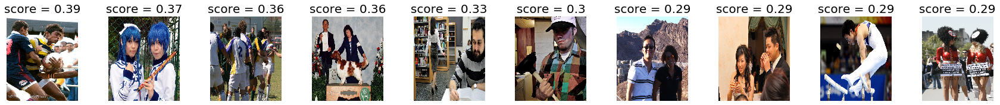

metric: number of co-active embedding features (out of 4096 features)


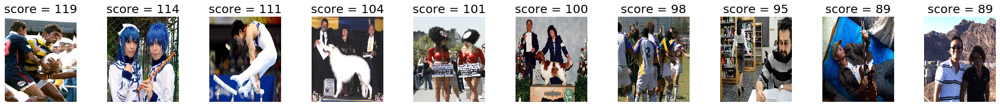

metric: cosine similarity between sub-embeddings


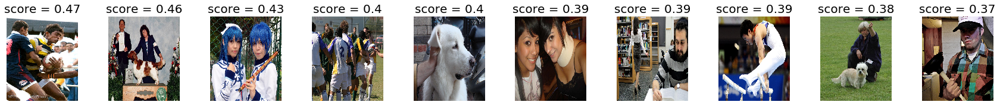

metric: number of co-active sub-embedding features (out of 4096 features)


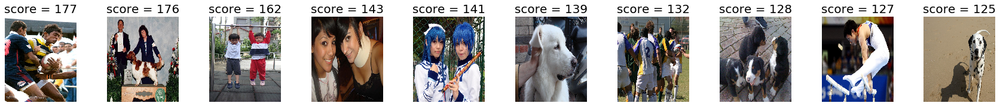

In [9]:
np.random.seed(10)
sampled_images = np.random.choice(range(1000),20,replace=False)

for main_img in sampled_images:
    img = mpimg.imread('random_pairs_cumulative/count_'+str(main_img)+'.jpg')
    plt.figure(figsize=(5.5,2.5))
    plt.imshow(img)
    plt.axis('off')
    plt.title('reference image')
    plt.show()
    for sim in range(4):
        fig,axs = plt.subplots(1,10, figsize = (24,2.5))
        fig.tight_layout(pad=2)
        plt.subplots_adjust(top=1.0)
        if sim == 0:
            print('metric: cosine similarity between embeddings')
            sorted_array = cos_sims_sorted
            similarity_array = cos_sims
            
        elif sim == 1:
            print('metric: number of co-active embedding features (out of 4096 features)')
            sorted_array = co_active_features_random_emb_sorted
            similarity_array = co_active_features_random_emb

        
        elif sim == 2:
            print('metric: cosine similarity between sub-embeddings')
            sorted_array = cos_sims_sorted_sub
            similarity_array = cos_sims_sub
            
        elif sim == 3:
            print('metric: number of co-active sub-embedding features (out of 4096 features)')
            sorted_array =co_active_features_random_subemb_sorted
            similarity_array = co_active_features_random_subemb

            
        #plt.suptitle(title,fontsize=15)
        
        for index in range(10):
            
            img_index = sorted_array[main_img,index+1]
            img = mpimg.imread('random_pairs_cumulative/count_'+str(img_index)+'.jpg')
            axs[index].imshow(img, aspect="auto")
            axs[index].axis('off')
            if sim == 0 or sim == 2:
                score = round(similarity_array[main_img,img_index], 2)
            else:
                score = similarity_array[main_img,img_index]
            axs[index].set_title('score = '+str(score),fontsize=20)
        plt.show()
        plt.close()